# SWARM GENERATOR
### Reporte de resultados
Este es un reporte con los resultados de los experimentos de las simulaiones realizadas por SWARM GENERATOR.Donde se han recopilado 57600 datos, de dos clases de software de control, para cuatro tipos de misiones.

SWARM GENERATOR fue testeado en:

* Arenas (5): Triangular, Cuadrada, Hexagonal, Octagonal, Dodecagonal
* Tamaños de las arenas (3): Pequeña, Mediana, Grande
* Clase software de control por misión (2): Clase A y Clase B
* Modos de operación (2): Sin Fallos (1), con Fallos (3) 10%, 20% y 30% del total del enjambre con fallos
* Tamaño del enjambre de robots: 2,5,10,20,30,40,50,60,70,80,90,100
* Duración de las misiones 240 segundos

## Contenido
En este informe encontraras resultados sobre el rendimiento de las misiones y la evaluación de las propiedades del enjambre de robots.

1. Resultados rendiemiento de la mision (Performance).
2. Resultados propiedades (Escalabilidad, Flexibilidad, Robustez).

Los resultados del rendimeinto de cada mision corresponden a una grafica de tipo "Boxplot", mientras que para la visualización de los resultados de las misiones usamos 
la visualización de "Heat map", esto con el fin de ver el efecto que tiene el cambio de parametros como la arena, su tamaño y la densidad del enjambre durante el desarrollo de la mision. 


## Misiones 

SWARM GENERATOR puede contemplar 5 tipos de misiones: Exploración, Agregación, sincronizacion, marcha en formación y toma de decisiones colectivas.

### Exploración:

Los robots deben explorar y cubrir el mayor espacio posible. El suelo es completamente gris. Al principio del experimento, los N robots se colocan aleatoriamente en el espacio de trabajo. Con el fin de medir el rendimiento del enjambre, la arena se dividido en una cuadrícula de N baldosas por N baldosas, dependiendo del tamaño de la arena. Para cada baldosa, conservamos el tiempo t transcurrido desde la última vez que fue visitada por un robot. Cada vez que la baldosa es visitada por un robot, este tiempo se pone a 0. El rendimiento del enjambre se mide por la suma sobre todos los ciclos de control del opuesto del tiempo medio t sobre todas las baldosas.

la función objetivo medida durante el desarrollo de la misión es:

$\begin{align}
F_{exploración}=\sum_{i=1}^{Ncc}(\frac{1}{N_{tiles}}\sum_{j=1}^{N_{Tiles}}-t_{ij})
\end{align}
$

Donde $N_{cc}$ es el número de ciclos de control para todo el experimento, $N_{Tiles}$ es el número de baldosas y $t_{ij}$ es el tiempo, en el ciclo de control $i$, desde que la baldosa $j$ fue fue atravesada por un robot.

### Agregación:

Los robots deben agregarse lo más rápido posible en un punto negro ubicado en el espacio de trabajo. El suelo es completamente gris excepto por un área circular negra de 3 m de diámetro ubicada de forma aleatoria en la arena de simulación. El rendimiento del enjambre se mide por la suma del total de robots que se encuentran en la zona de agregación al final de la misión.

La función obejetivo para obtener el performance de la misión es la siguiente:

$
\begin{align}
F_{agregacion}=\sum_{i=1}^{N}T_{i}
\end{align}
$

Donde $N$ es el numero de robots y $T_{i}$ es el tiempo de agregación que permanece el robot $i$ en la zona negra, durante la duración de la mision.

### Marcha en formación:

En esta misión, el enjambre de robots debe cubrir uniformemente una región objetivo en la arena. 
La región objetivo es un área cualquiera en la arena de simulación o la misma arena en si. Al comienzo de cada experimento, los robots se colocan aleatoriamente.

El mejor rendimiento se logra cuando se minimiza la siguiente función objetivo:

$
\begin{align}
F_{1}(T) = E[d(t)]^{2}
\end{align}
$
donde $f_{1}(T)$ es el cuadrado de la distancia esperada $E[d(T )]$, medida sólo una vez al final del experimento. $E[d(T)]$ es la distancia esperada, en el tiempo $T$, entre un punto genérico dentro de la región objetivo y su robot más cercano dentro de la región objetivo (Arena de simulación). Se estima $E[d(T )]$ calculando la distancia promedio entre cualquier punto dentro de la región objetivo (en la práctica, un conjunto suficientemente grande de puntos muestreados aleatoriamente) y su robot más cercano P dentro de la región objetivo. Más precisamente, $E[d(T)] ≈ \sum_{p=1}^{P} min_{i}(d_{ip})/P$ ; dónde $p ∈ [1, 1000]$ es un punto en un conjunto de puntos muestreados aleatoria y uniformemente dentro de la región objetivo; y $i ∈ [N_{robots}]$ es un robot en el conjunto de robots que están dentro de la región objetivo en el tiempo $T$. La distancia $d_{ip}$ es, por lo tanto, la distancia entre un punto aleatorio $p$ y un robot $i$ que están ambos dentro de la región objetivo.

### Toma de decisiones colectiva:

En esta misión, el enjambre de robots debe interactuar con otros robots para llegar a un consenso para brillar en un solo color entre rojo, verde y azul. 
El mejor rendiemiento de logra cuando un porcentaje mayor o igual al 80% del enjambre llega a un consenso. 
La función objetivo para obtener el rendimiento de la misión es la siguiente:

$\begin{align}
F_{Consenso}(T) = \frac{\sum_{i=1}^{N}Robot_{C}}{N}(T)
\end{align}$

Donde $N$ es la cantidad total de robots que estan llevando a cabo la mision, $Robot_{C}$ son la cantidad de robots que estan emitiendo un color donde $C ∈ [Rojo, Verde, Azul]$, y $T$ el tiempo de simulación en el que se llega al consenso.

## Propiedades de los enjambres de robots

Estos sistemas poseen tres propiedades, que en una primera medida son deseables, y en una segunda, fundamentales para el diseño de un enjambre de robots.
### * $\textit{\textbf{Robustez:}}$ 
Se asocia con su capacidad para tolerar fallos. Como estos tipos de sistemas se caracterizan por estar compuestos por un gran número de individuos sin importar que, una, dos o mas de estas unidades de robots falle, o que se presenten alteraciones en el entorno. El funcionamiento global del enjambre no se ve gravemente afectado. La perdida o fallo de operación de uno de los individuos, puede ser compensada por otro individuo.

¿Comó medir robustez? 

Para medir la robustez de en los enjmabres de robots, se deben tener en cuenta dos aspector importantes: (1) El efecto de los robots que fallan en el rendimiento del grupo.  
(2) El efecto de los robots defectuosos en los robots no defectuosos. Esto quiere decir que el enjambre debe permitir una sutil degradación en presencia de fallos en el sistema. 

Por lo tanto, si "$m$" robots de un total $N$ de robots han fallado por $X$ falla. Se considera que existe una buena robustez cuando: $\textbf{El porcentaje de cambio en el rendimiento del enjambre debido a los fallos es MENOR}$ que el cambio porcentual en el rendimiento de una enjambre en buen funcionamiento con $N-m$ robots.

La robustez de un enjmabre de robots se define como:
$
\begin{align}
R = \%\Delta P - \%\Delta N \\ 
\%\Delta P = \frac{P_{f}-P_{0}}{P_{0}}  \\
\%\Delta N = \frac{m}{N}
\end{align}
$
Donde $ R > 0$ quiere decir que el sistema es robusto. 
$P_{f}$ corresponde al performance del enjambre con fallos, $P_{0}$ es el performance del enjambre sin fallos, $N$ es el total de robots del enjambre y $m$ la cantidad de robots que estan fallando respecto al total $N$.

### * $\textit{\textbf{Escalabilidad:}}$ 
Se define como la capacidad de añadir o quitar unidades de robots al enjambre, sin que se afecte su funcionamiento.
La escalabilidad requiere que el enjambre de robots, sea capaz de operar sin importar el tamaño del enjambre o densidad.

¿Comó medir escalabilidad?

Para medir escalabilidad en los enjambres de robots se toman en cuenta dos aspectos importantes: (1) El rendimiento del enjmabre de robots, no decrece cuando se incrementa el tamaño. (2) EL rendimiento del enjambre crece a medida de que el tamaño aumenta. En escalabilidad se espera que la condición mínima para que un sistema de enjambres de robots se considera escalable es que $\textbf{el rendimiento del enjambre siga siendo AL MENOS para N agentes de robots como para N+m agentes de robots}$.

La escalabilidad se define como:

$
\begin{align}
    S = \frac{\%\Delta P}{\%\Delta N} \\
\end{align}
$

$
\begin{align}
    \%\Delta P = \frac{P_{N+m}-P_{N}}{P_{N}} \\
    \%\Delta N = \frac{m}{N}
\end{align}
$

Donde $P_{N}$ es el rendimiento del enjambre original, $P_{N+m}$ es el rendimiento del enjmabre cuando se aumenta $N+m$ robots. $N$ es el total del enjambre de robots original y $m$ la cantidad de robots que se adicionan con respecto al tamaño inicial.

El sistema es escalable cuando el cambio de rendimiento es positivo. Esto quiere decir que $S > 0$. Un caso particular es cuando $S > 1$, lo que significa que el sistema es escalable y superlineal.


### * $\textit{\textbf{Flexibilidad:}}$ 
Se define como la capacidad de estos enjambres de robots de adaptarse fácilmente a diferentes tipos de tareas y cambios en el entorno.
La flexibilidad se ve favorecida gracias a que estos enjambres de robots son altamente redundantes.

¿Comó medir flexibilidad?

Un sistema es flexible o adaptable  cuando no existen cambios o perdididas significativas en su rendimiento.  Dicho sistema debe ser adaptable a $"X"$ cambios como: Obstaculos, cambios en el tamaño del escenario de simulación, brillos de luz, tipo de tarea y sus parametros de operación.

La flexibilidad se define como:

$
\begin{align}
A = \frac{\%\Delta P}{|\%\Delta X|}+1
\end{align}
$

$
\begin{align}
    \%\Delta P = \frac{P_{New}-P_{0}}{P_{0}} \\
    \%\Delta X = \frac{X_{New-X_{0}}}{X_{0}}
\end{align}
$

Donde $P_{New}$ es el rendimiento del enjambre con cambios en el parametro $X$, $P_{0}$ es el rendimiento del enjambre sin cambios en el parametro $X$, $X_{new}$ son las nuevas condiciones en el parametro $X$ y $X_{0}$ las condiciones iniciales del parametro $X$. Las condiciones deben ser las mismas en los dos casos con la diferencia de consideración del parámetro $X$ entre los dos experimentos.

Un sistema es adaptable a cambios en el parámetro externo $X$, si cualquier perdida de rendimiento $\%\Delta P$ es $\textbf{menor}$ que el cambio proporsional en el parámetro $X$ ( $\%\Delta X$). Por lo tanto El sistema es flexible o adaptable si $A > 0$.

Un caso particular es cuando $A > 1$ lo que significa que la flexibilidad o adaptabilidad es muy buena.

A continuación veeremos los resultados de los experimentos, recuerda que el set completo de datos se encuentra en la carpeta "Experimentos" y el set completo de plots se encuentra en la carpeta "Plots-Experimentos".

In [1]:
import os
from IPython.display import Image, display
import matplotlib.pyplot as plt
ruta_imagen = "/home/gmadro/swarm_robotics/SWARM_GENERATOR/Plots-Experimentos" 

def mostrar_imagenes(ruta_imagen_A, ruta_imagen_B):
    """
    Muestra dos imágenes una al lado de la otra.
    """
    fig, axs = plt.subplots(1, 2, figsize=(20,20),dpi=600)
    imagen_A = plt.imread(ruta_imagen_A)
    imagen_B = plt.imread(ruta_imagen_B)
    axs[0].imshow(imagen_A)
    axs[0].axis('off')
    axs[1].imshow(imagen_B)
    axs[1].axis('off')
    plt.show()
def mostrar_imagen(ruta_imagen):
  """
  Muestra una imagen en el notebook.
  Args:ruta_imagen (str): Ruta de la imagen.
  """
  display(Image(filename=ruta_imagen))
  
def listar_archivos(ruta, mision):
    """
    Devuelve una lista con las rutas de los archivos que pertenecen a una misión específica.
    """
    archivos = os.listdir(ruta)
    # Filtrar los archivos 
    archivos_filtradosA = [archivo for archivo in archivos if archivo.startswith(mision+"A")]
    archivos_filtradosB = [archivo for archivo in archivos if archivo.startswith(mision+"B")]
    
    # Combinar y ordenar ambos conjuntos de archivos
    archivos_combinados = archivos_filtradosA + archivos_filtradosB
    archivos_combinados.sort()

    # Dividir la lista ordenada en dos listas nuevamente
    idx = len(archivos_filtradosA)
    archivos_filtradosA = archivos_combinados[:idx]
    archivos_filtradosB = archivos_combinados[idx:]

    return archivos_filtradosA, archivos_filtradosB



# RESULTADOS EXPERIMENTOS

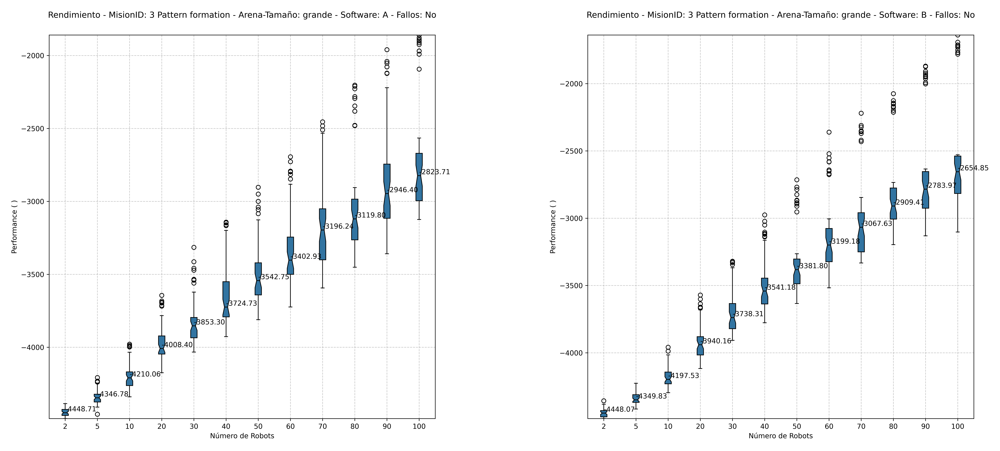

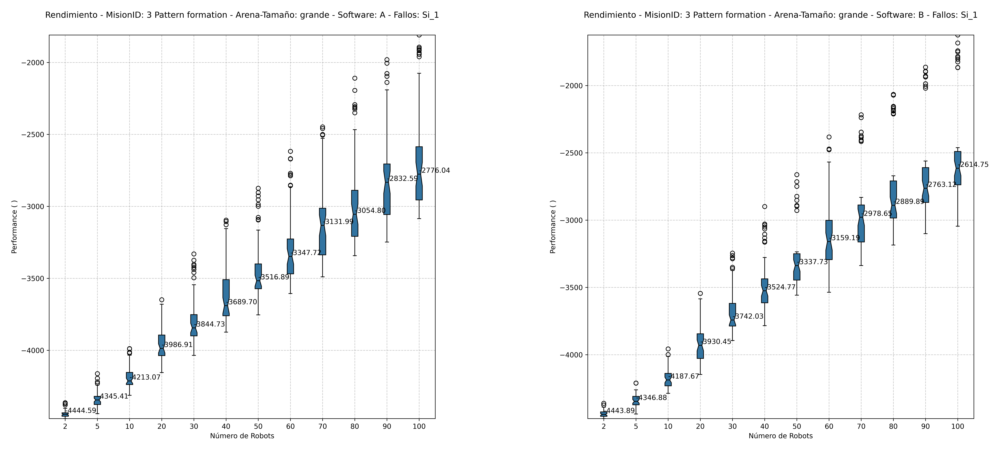

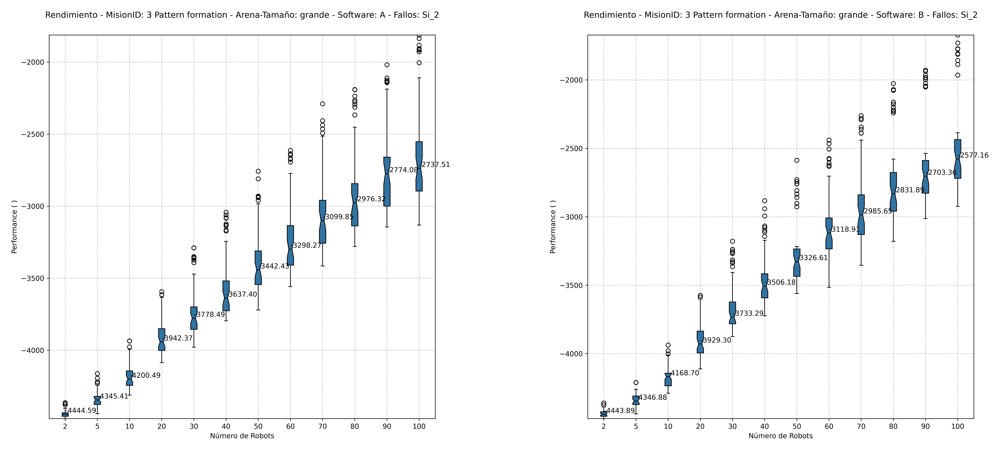

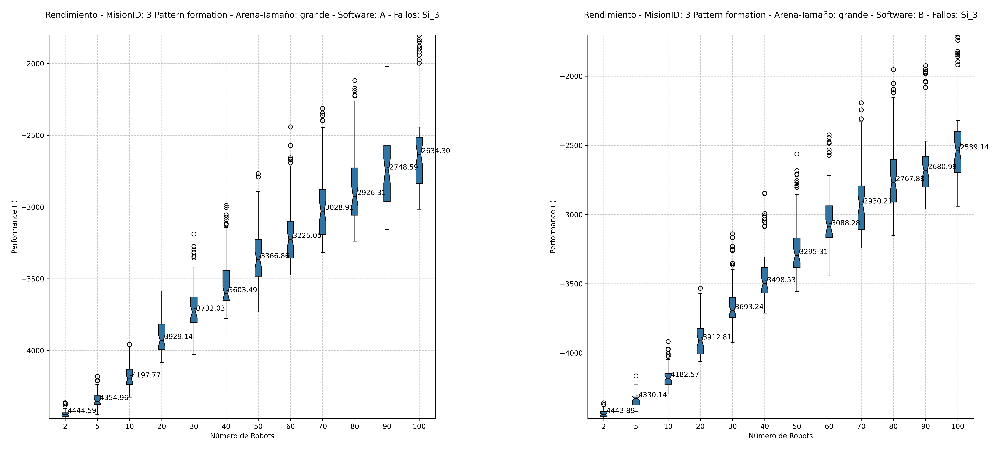

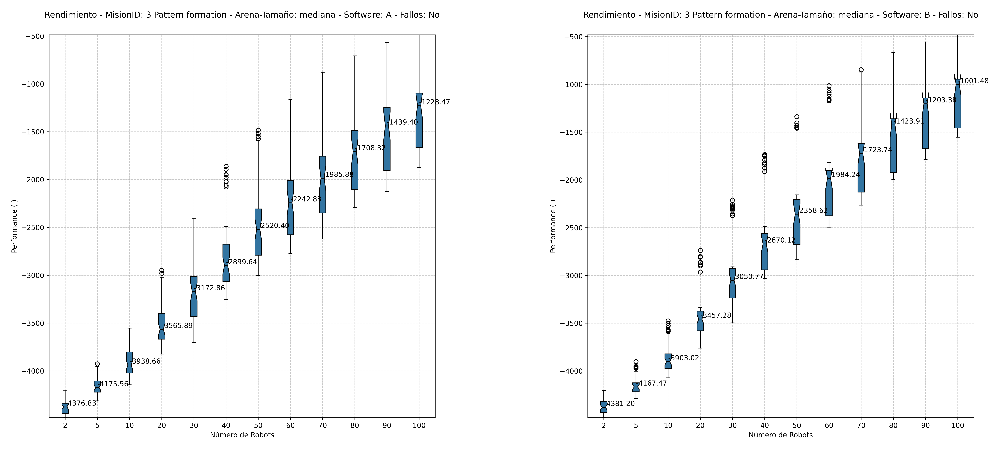

...

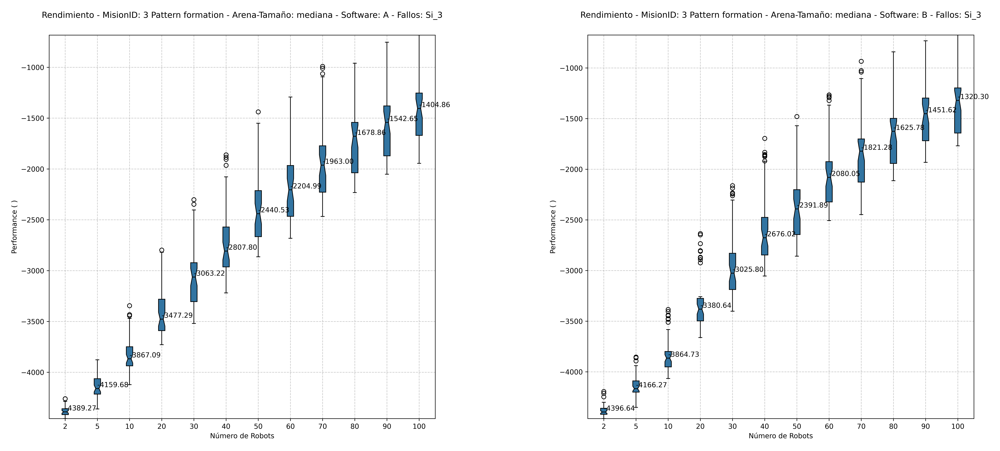

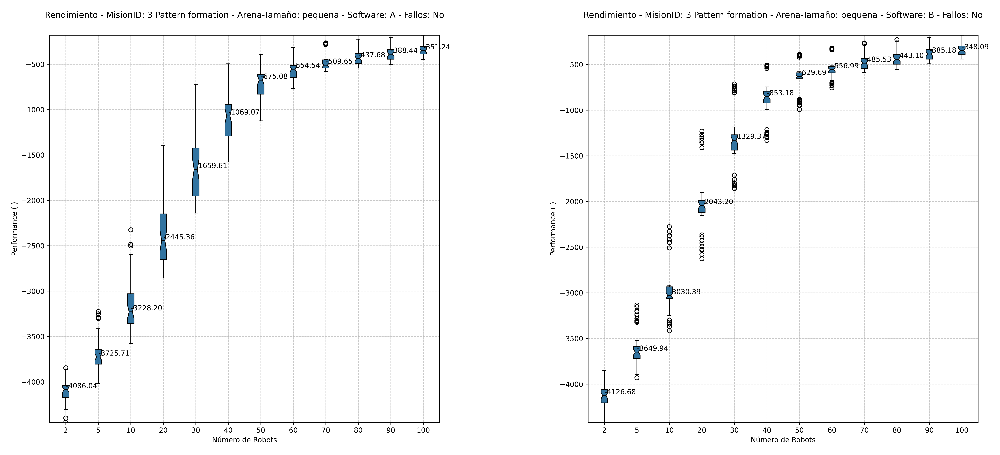

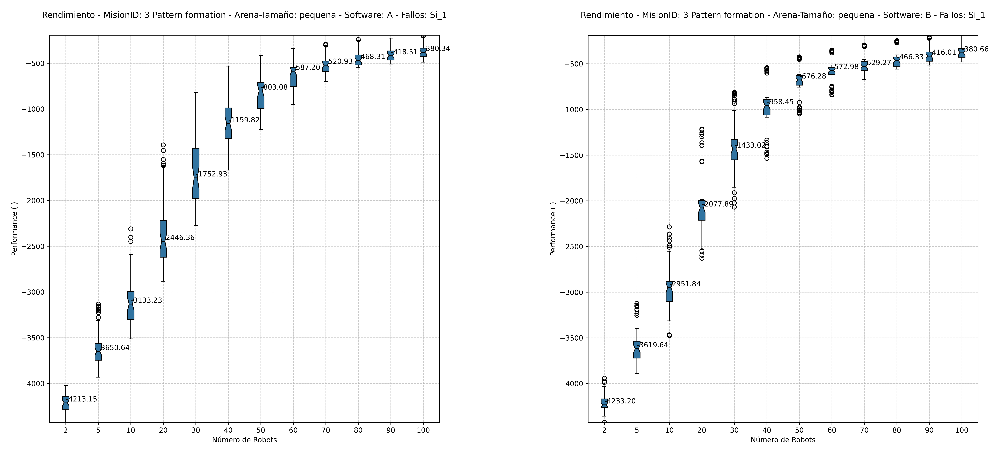

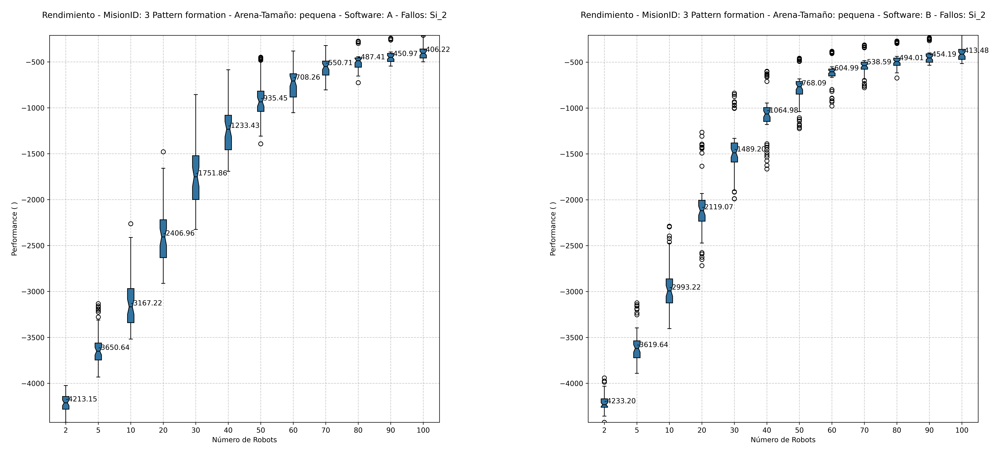

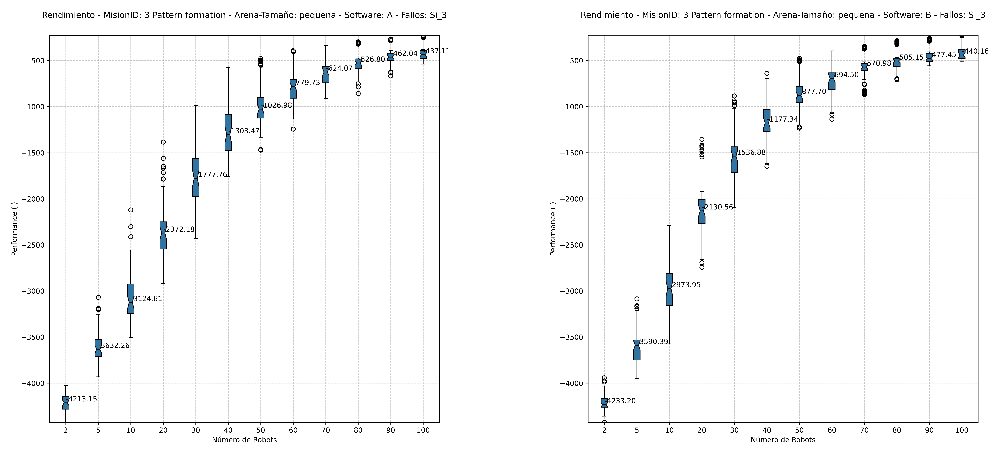

In [2]:
"""
# Misión: especifica el id de la mision que deseas ver 
1. Exploracion
2. Agregacion
3. Marcha en formación
4. toma de decisiones colectiva
"""
"""RESULTADOS DE RENDIMIENTO DE LA MISION"""
mision = "3" # id de la mision
rendimientoA, rendimientoB= listar_archivos(ruta_imagen,mision)
for i in range(len(rendimientoA)):
    ruta_imagen_A = ruta_imagen+"/"+rendimientoA[i]
    ruta_imagen_B = ruta_imagen+"/"+rendimientoB[i]
    mostrar_imagenes(ruta_imagen_A, ruta_imagen_B) # GRAFICAS DE RENDIMIENTO


### Propiedades enjambres de robots

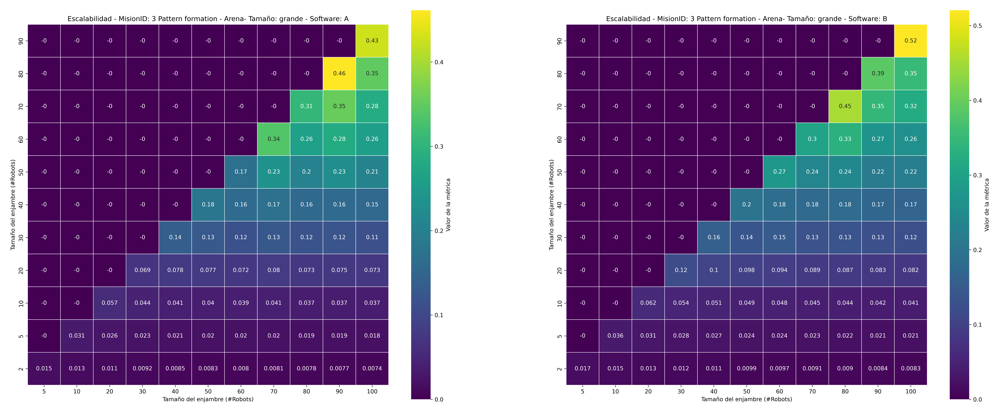

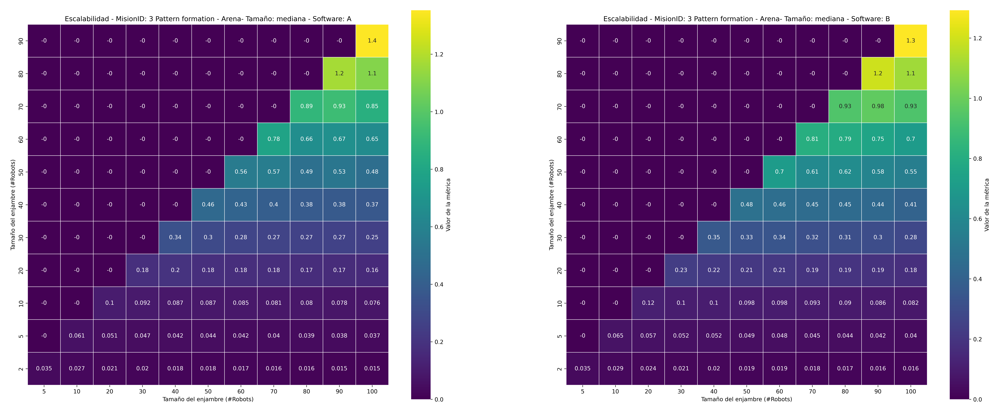

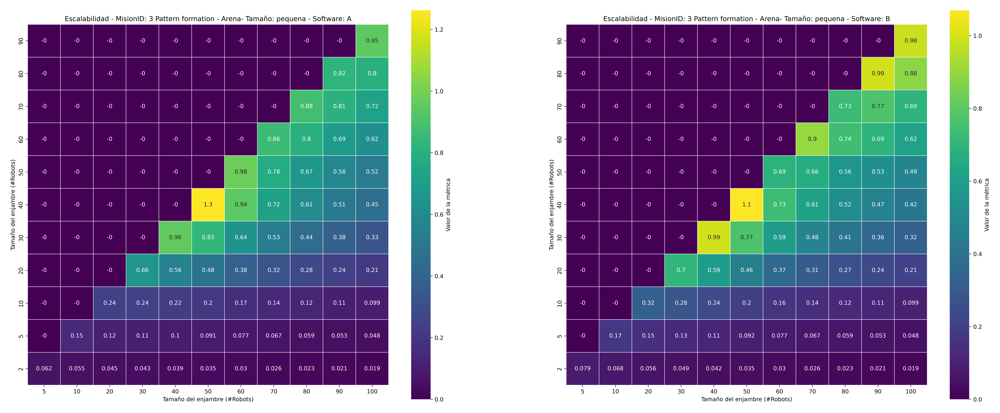

In [3]:
"""RESULTADOS ESCALABILIDAD"""
escalabilidad = ruta_imagen+"/Escalabilidad"
Escala_A, Escala_B= listar_archivos(escalabilidad,mision)
for i in range(len(Escala_A)):
    escala_imagen_A = escalabilidad+"/"+Escala_A[i]
    escala_imagen_B = escalabilidad+"/"+Escala_B[i]
    mostrar_imagenes(escala_imagen_A, escala_imagen_B) # GRAFICAS PROPIEDAD ESCALABILIDAD

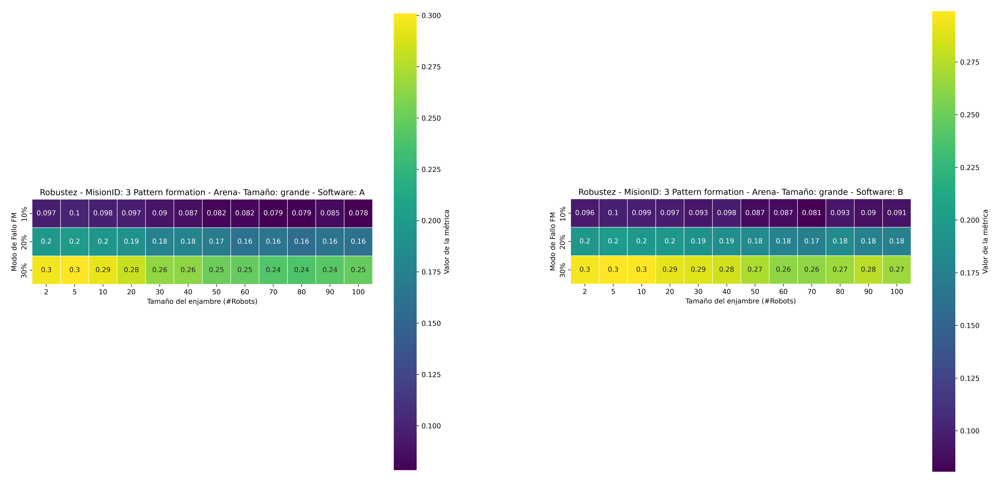

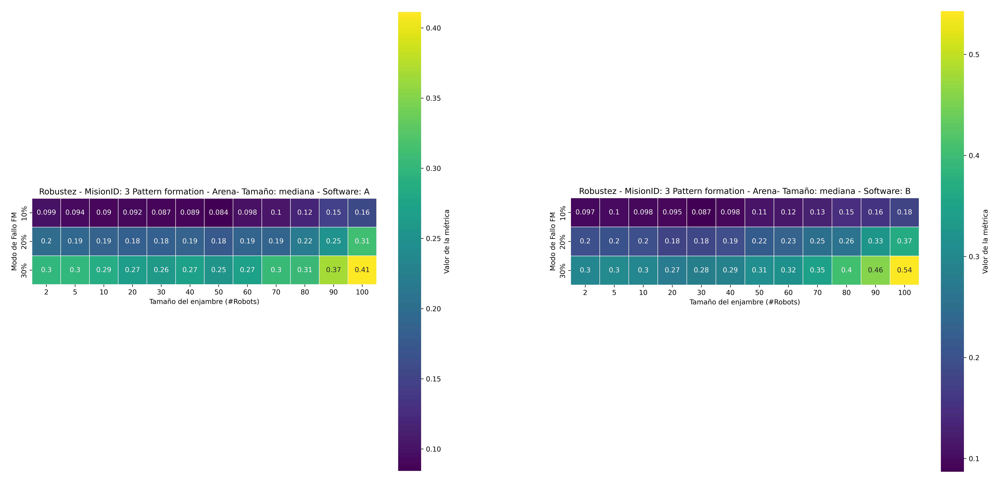

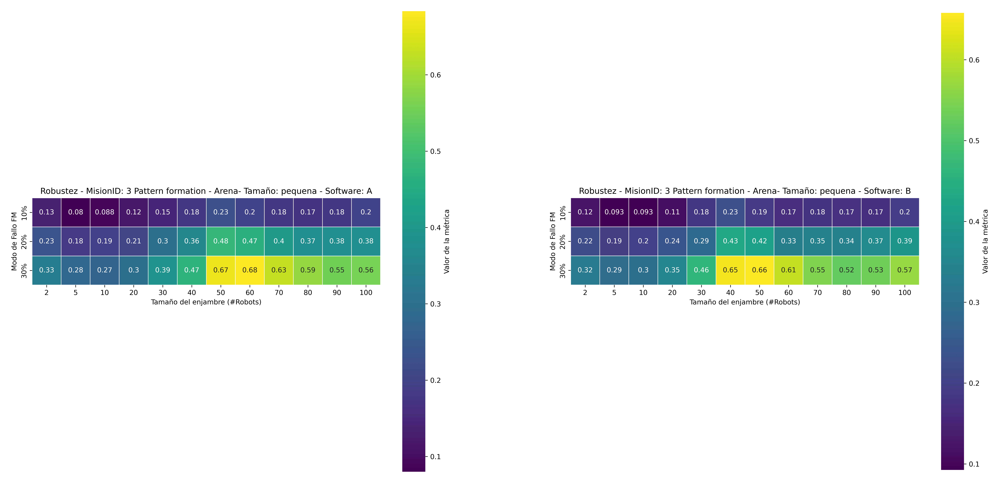

In [4]:
"""RESULTADOS ROBUSTEZ"""
robustez = ruta_imagen+"/Robustez"
Robu_A, Robu_B= listar_archivos(robustez,mision)
for i in range(len(Robu_B)):
    robu_imagen_A = robustez+"/"+Robu_A[i]
    robu_imagen_B = robustez+"/"+Robu_B[i]
    mostrar_imagenes(robu_imagen_A, robu_imagen_B) # GRAFICAS PROPIEDAD ROBUSTEZ

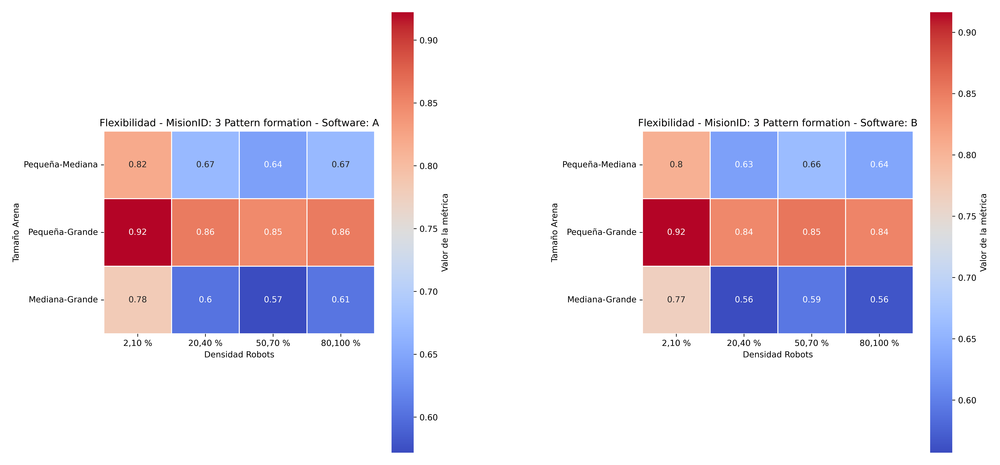

In [5]:
"""RESULTADOS FLEXIBILIDAD"""
flexibilidad = ruta_imagen+"/Flexibilidad"
Flex_A, Flex_B= listar_archivos(flexibilidad,mision)
for i in range(len(Flex_B)):
    fle_imagen_A = flexibilidad+"/"+Flex_A[i]
    fle_imagen_B = flexibilidad+"/"+Flex_B[i]
    mostrar_imagenes(fle_imagen_A, fle_imagen_B) # GRAFICAS PROPIEDAD ROBUSTEZ

In [6]:
"""EXPORTAR REPORTEDE RESULTADOS EN HTML"""
# Nombre de tu notebook actual
nombre_notebook = 'reporte.ipynb'

# Nombre del archivo HTML de salida
nombre_html_salida = f'reporte_mision{mision}.html'

# Directorio donde se guardará el archivo HTML
directorio_destino = '/home/gmadro/swarm_robotics/SWARM_GENERATOR/Reporte-Resultados'

# Llama a la función para convertir a HTML
os.system(f'jupyter nbconvert --to html {nombre_notebook} --output-dir {directorio_destino} --output {nombre_html_salida}')

[NbConvertApp] Converting notebook reporte.ipynb to html
[NbConvertApp] Writing 300934 bytes to /home/gmadro/swarm_robotics/SWARM_GENERATOR/Reporte-Resultados/reporte_mision3.html


0